In [1]:
import sys
import os
import geopandas as gpd
import pandas as pd

sys.path.append(os.path.abspath(os.path.join(os.pardir)))

from VASA import VASA

In [10]:
help(VASA)

Help on class VASA in module VASA.vasa:

class VASA(builtins.object)
 |  VASA(df: 'str or pd.DataFrame', gdf: 'gpd.GeoDataFrame', df_group_col: 'str' = 'fips', gdf_group_col: 'str' = 'fips', date_col: 'str' = 'date', date_format: 'str' = '%Y-%m-%d', temp_res: "Literal[('day', 'week', 'month', 'year')]" = 'week') -> 'None'
 |  
 |  A standard data object for VASA plots
 |  
 |  
 |  Parameters
 |  ----------
 |  
 |  
 |  Attributes
 |  ----------
 |  
 |  
 |  Examples
 |  --------
 |  >>> import libpysal
 |  
 |  Methods defined here:
 |  
 |  __init__(self, df: 'str or pd.DataFrame', gdf: 'gpd.GeoDataFrame', df_group_col: 'str' = 'fips', gdf_group_col: 'str' = 'fips', date_col: 'str' = 'date', date_format: 'str' = '%Y-%m-%d', temp_res: "Literal[('day', 'week', 'month', 'year')]" = 'week') -> 'None'
 |      DOCSTRING
 |  
 |  agg(self, ag)
 |      # I want to change the name of this
 |  
 |  drop_missing(self, thresh: 'int' = 0.2)
 |  
 |  get_county(self, fips: 'int', date='all') -> 

In [11]:
mob_data.columns

Index(['ds_m4', 'fips', 'sg_sheltered', 'sheltered_in_place_7days_rolling_avg',
       'sg_avg_dist2', 'cmi_7days_rolling_avg'],
      dtype='object')

In [2]:
from VASA.vasa import filter_data, filter_map

In [3]:
mob_data = pd.read_csv("../data/all_minor_sources.csv")

# THIS CELL MAY NEED TO BE CHANGED

# Make sure this string matches the column name for the mobility values
# If you have multiple measures in your dataset, it's easiest if you just pick one
columns = [
    'sg_sheltered', "sheltered_in_place_7days_rolling_avg", "sg_avg_dist2", "cmi_7days_rolling_avg"
]

# Make sure this string matches the column name you have for the dates
date_col = "ds_m4"

# Make sure this string matches the column name you have for the county fips
fips_col = "fips"



# This is just used to put text on the plot, it doesn't really make what it says...
titles = [
    '% sheltered (Safegraph)'
]

mob_data = mob_data[["ds_m4", "fips", *columns]]

# Read the map 
usa_map_data = pd.read_json("../data/counties.json")
usa_map = gpd.GeoDataFrame \
    .from_features(usa_map_data["features"]) \
    .set_crs(epsg=4326) \
    .to_crs("+proj=aea +lat_1=20 +lat_2=60 +lat_0=40 +lon_0=-96 +x_0=0 +y_0=0 +datum=NAD83 +units=m +no_defs")
usa_map = usa_map.assign(fips=[int(g) for g in usa_map["GEOID"]])
usa_map = filter_map(usa_map)

# Group the data into weeks
data = mob_data # filter_data(mob_data, fips_col)
# grouped_usa = group_data(data, columns, date_col, fips_col, by="week")

In [4]:
data = data[[str(d)[:4] == "2020" for d in data["ds_m4"]]]

In [15]:
from __future__ import annotations
from typing import Literal, Tuple, Callable, List

import numpy as np
import pandas as pd
import geopandas as gpd
import libpysal as lps
from esda import Moran_Local

from functools import partial
# from concurrent import futures
from multiprocessing import cpu_count, Pool
from datetime import datetime as dt

# Commented out for testing...
# from .reduce_vasa_df import *


class VASA:
    """
    A standard data object for VASA plots


    Parameters
    ----------


    Attributes
    ----------


    Examples
    --------
    >>> import libpysal


    """
    def __init__(
        self,
        df: str or pd.DataFrame,
        gdf: gpd.GeoDataFrame,
        df_group_col: str = "fips",
        gdf_group_col: str = "fips",
        date_col: str = "date",
        date_format: str = "%Y-%m-%d",
        temp_res: Literal["day", "week", "month", "year"] = "week"
    ) -> None:
        """
            DOCSTRING
        """
        if isinstance(df, str):
            df = pd.read_csv(df)
        elif not isinstance(df, pd.DataFrame):
            raise Exception("Data not of proper type")

        self.df = df.copy()
        self.df_group_col = df_group_col
        self.gdf = gdf
        self.gdf_group_col = gdf_group_col
        self.date_col = date_col
        self.date_format = date_format
        self.temp_res = temp_res

        self.cols: List[str] = list(
            set(df.columns) - {self.df_group_col, self.date_col}
        )

        # Convert date column to dates
        if isinstance(self.df[self.date_col].dtypes, object):
            self.df[self.date_col] = self.df[self.date_col].apply(
                lambda x: dt.strptime(x, self.date_format).date()
            )
        # NUMPY DATES ??

        # self.group()

    # WE NEED TO CHECK IF THERE IS ONLY ONE GROUP.
    # IF WE ONLY HAVE DATES Jan 1-6, Are these always grouped together?
    def group(self) -> None:
        # pass in functions other than mean
        agg_dict = dict(zip(
            [*self.cols, self.date_col],
            [*np.repeat(np.nanmean, len(self.cols)), "min"]
        ))

        if self.temp_res == "day":
            # assign year_month_day
            grouped = self.df
        elif self.temp_res == "week":
            year_week = [
                get_year_week(date)
                for date in self.df[self.date_col]
            ]

            grouped = self.df \
                .assign(
                    year_week=year_week
                ) \
                .groupby(["year_week", self.df_group_col]) \
                .agg(agg_dict) \
                .reset_index() \
                .groupby(["year_week"])

        elif self.temp_res == "month":
            # assign year_month
            grouped = self.df
        elif self.temp_res == "year":
            # assign year
            grouped = self.df
        else:
            raise Exception("Incorrect temporal resolution")

        # this is going to have to be based on the map or something
        output = pd.DataFrame()
        for _, group in grouped:
            ordered = pd.merge(
                self.gdf, group,
                left_on=self.gdf_group_col, right_on=self.df_group_col,
                how='left'
            )

            output = output.append({
                "date": ordered.loc[0, self.date_col],
                **{c: ordered[c] for c in self.cols}
            }, ignore_index=True)

        self.fips_order = ordered[self.gdf_group_col]
        self.dates = output["date"]
        self.df = output
        # return (output, ordered[self.gdf_group_col])

    # specify column...
    def get_county(self, fips: int, date="all") -> List[int]:
        i = list(self.fips_order).index(fips)
        return [row[self.cols[0]][i] for _, row in self.df.iterrows()]

    # df / list idk, specify columns
    def get_week(self, i: int) -> pd.DataFrame:
        return self.df.loc[i, self.cols[0]]

    def save_output(self, date, fips, vars):
        return 1

    def lisa(self) -> None:
        num_processes = cpu_count()

        W = lps.weights.Queen(self.gdf["geometry"])
        W.transform = 'r'

        with Pool(num_processes) as pool:
            for col in self.cols:

                self.df[col] = list(
                    pool.map(
                        partial(func, col=col,
                                W=W, sig=0.05, which="fdr"),
                        [row for _, row in self.df.iterrows()]
                    )
                )

    def reduce(
        self,
        # this could return anything really...
        reduce: (
            Literal["count", "recency", "count_hh", "count_ll", "mode"] |
            Callable[[List[List[int]]], List[int]]
        )
    ) -> pd.DataFrame:
        copy: pd.DataFrame = self.df[self.cols].copy()

        if reduce == "count":
            reduce = reduce_by_count
        elif reduce == "count_hh":
            reduce = reduce_by_count_hh
        elif reduce == "count_ll":
            reduce = reduce_by_count_ll
        elif reduce == "recency":
            reduce = reduce_by_recency
        elif reduce == "mode_sig":
            reduce = reduce_by_mode_sig
        elif reduce == "mode":
            reduce = reduce_by_mode

        return copy \
            .agg(reduce) \
            .assign(fips=self.fips_order)

    # I want to change the name of this
    def agg(self, ag):
        return 1


def func(ordered, col, W, sig, which):
    return moran_quadrants(ordered[col], W, sig, which=which)

# esda fdr is not strictly doing fdr


def false_discovery_rate(arr, sig):
    df = pd.DataFrame(arr, columns=["p"]).sort_values("p")
    df["i"] = np.arange(1, len(arr) + 1) * sig / len(arr)
    df["sig"] = df["p"] < df["i"]
    return list(df.sort_index()["sig"])


def bonferroni(arr, sig):
    return list(np.array(arr) < sig / len(arr))


# We don't want to filter
def filter_quadrants(arr):
  #  return arr
    return [(a if a < 3 else a) for a in arr]


# this needs to change if we don't filter
def combine(sim, fdr, bon):
    return [
        (b + 4 if b != 0 else (f + 2 if f != 0 else s))
        for b, f, s in zip(bon, fdr, sim)
    ]

#
#
#
#
#

#
# This function runs the local moran test for us and returns an array of
# the quadrant classification for each county
#
#


#
# STILL GET THE ISSUE WHERE VERYTHING IS A 2 
#
def moran_quadrants(col, W, alpha, which):
    local_moran = Moran_Local(col, W, geoda_quads=True,
                              permutations=n_permutations(col))

    ps = local_moran.p_sim
    qs = filter_quadrants(local_moran.q)

    if which == "fdr":
        f = false_discovery_rate(ps, alpha)
    elif which == "sim":
        f = [p < alpha for p in ps]
    elif which == "bon":
        f = bonferroni(ps, alpha)
    elif which == "all":
        fdr = false_discovery_rate(ps, alpha)
        bon = bonferroni(ps, alpha)
        sim = [p < alpha for p in ps]

        qs = combine(
            qs * np.array(sim),
            qs * np.array(fdr),
            qs * np.array(bon)
        )
        f = sim
    else:
        raise 'Valid p-value evaluations: "bon", "fdr", or "sim"'

    return list(qs * np.array(f))


def n_permutations(df):
    return 999  # default value


def get_year_week(date: dt) -> Tuple[int, int]:
    """
    get_year_week [summary]

    Args:
        date (dt): [description]

    Returns:
        Tuple[int, int]: [description]
    """
    week_num = date.isocalendar()[1]
    year = date.year

    if week_num == 1 and date.month == 12:
        year += 1
    elif week_num == 53 and date.month == 1:
        year -= 1

    # Year comes first so dataframe is sorted chronologically
    return (year, week_num)

#
#
#

def _filters(n, coverage="usa", excl_non48=True):
    output = True

    if n == 11001: # DC
        output = False
    if excl_non48 and n >= 2000 and n <= 2999: # exclude AK
        output = False
    if excl_non48 and n >= 15001 and n <= 15009: # exclude HI
        output = False
    if n >= 60010: # territories and such
        output = False
    if n == 53055 or n == 25019: # ISLANDS WITH NO NEIGHBORS
        output = False
    if n == 51515: # Bedford County VA, code was changed in 2013
        output = False

    return output

def filter_data(data, fips_col, coverage="usa", excl_non48=True):
    filters = [
        _filters(x[fips_col], coverage, excl_non48) for _, x in data.iterrows()
    ]
    return data.loc[filters]

def filter_map(data, coverage="usa", excl_non48=True):
    # remove ? - I was doing something different for maps...

    filters = [
        _filters(x["fips"], coverage, excl_non48) for _, x in data.iterrows()
    ]
    return data.loc[filters]



In [16]:
# This is not going to be front facing so it's nice if we have
# general comments but odn't need documentation or doc strings

"""
Utility Reducing Functions for VASA Object
-------------------------------------------------------

Three types:
    * Reducing by count:
        Adding up the total number of times the
        county attained some LISA classification.

    * Reducing by recency:
        The last week number of the time a county
        attained some LISA classification.

    * Reducing by mode:
        The most often LISA classification of a county.
"""

from typing import List, Tuple, Callable
from functools import reduce
import numpy as np
from scipy.stats import mode

HC_List = List[Tuple[int, int]]
County_History_List = List[List[int]]
County_list = List[int]


def reduce_by_count(arr: County_History_List) -> HC_List:

    # Start with pairs of 0 for each county
    initial: HC_List = [(0, 0) for _ in range(len(arr[0]))]

    reducer: Callable[[HC_List, List[int]], HC_List] = lambda acc, curr: [
        (a[0] + (c == 1), a[1] + (c == 2)) for a, c in zip(acc, curr)
    ]

    hh_ll: HC_List = reduce(
        reducer,
        arr,
        initial
    )

    return hh_ll


def reduce_by_count_hh(arr: County_History_List) -> County_list:
    return reduce_by_count_equals(arr, 1)


def reduce_by_count_ll(arr: County_History_List) -> County_list:
    return reduce_by_count_equals(arr, 2)

#
# No tests since called from reduce_by_count_**
#
def reduce_by_count_equals(arr: County_History_List, val: int) -> County_list:
    return list(reduce(
        lambda acc, curr: np.array(acc) + (np.array(curr) == val),
        arr,
        np.zeros(len(arr[0]))
    ))


# ughhh this needs to be made better
# this should return a date for each classification....
def reduce_by_recency(arr: County_History_List) -> County_list:
    return [
        (hh if clas == 1 else (ll if clas == 2 else 0))
        for hh, ll, clas in zip(
            reduce_by_recency_hh(arr),
            reduce_by_recency_ll(arr),
            reduce_by_mode_sig(arr)
        )
    ]


def reduce_by_recency_hh(arr: County_History_List) -> County_list:
    return reduce_by_recency_equals(arr, 1)


def reduce_by_recency_ll(arr: County_History_List) -> County_list:
    return reduce_by_recency_equals(arr, 2)

#
# THIS MUST ADD 1 so that we can tell the difference between week 0 and no week at all
# This doesn't need tests because called from reduce_by_recency_**
#
def reduce_by_recency_equals(
    arr: County_History_List,
    val: int
) -> County_list:
    return [
        max([
            (idx + 1 if week[county_idx] == val else 0)
            for idx, week in enumerate(arr)
        ])
        for county_idx in range(len(arr[0]))
    ]


# not really mode b/c prefers sig over non-sig
# change to list for loop thingy
def reduce_by_mode_sig(arr: County_History_List) -> County_list:
    output: County_list = []

    for hh, ll in reduce_by_count(arr):
        region_class = 1 if hh > ll else 2
        output.append(region_class if max(hh, ll) > 0 else 0)

    return output


def reduce_by_mode(arr: County_History_List) -> County_list:
    return [
        mode([
            week[county_idx]
            for week in arr
        ])[0][0]  # argh
        for county_idx in range(len(arr[0]))
    ]


In [17]:
data.columns

Index(['ds_m4', 'fips', 'sg_sheltered', 'sheltered_in_place_7days_rolling_avg',
       'sg_avg_dist2', 'cmi_7days_rolling_avg'],
      dtype='object')

In [5]:
v = VASA(data, usa_map, date_col="ds_m4")
v.group()

In [6]:
v.df = v.df[:-2]

In [7]:
v.pct_full_missing()

array([0., 0., 0., 0.])

In [8]:
v.pct_partial_missing()

array([0., 0., 0., 0.])

In [9]:
v.drop_missing()

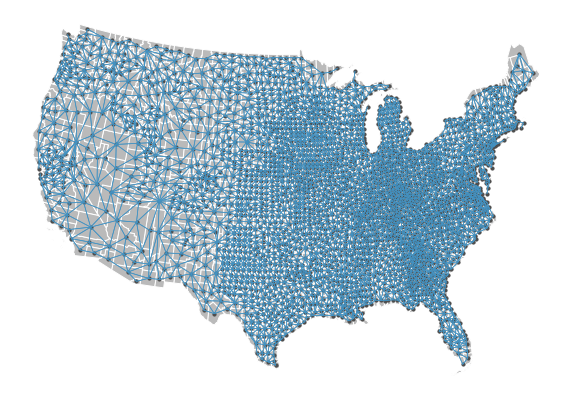

In [10]:
v.show_weights_connection()

In [8]:
v.impute()

In [11]:
v.lisa()

In [12]:
v.reduce("count")

,cmi_7days_rolling_avg,sheltered_in_place_7days_rolling_avg,sg_avg_dist2,sg_sheltered,fips
0,"(0, 3)","(8, 0)","(0, 1)","(35, 0)",6075
1,"(0, 9)","(20, 0)","(0, 19)","(29, 0)",25025
2,"(0, 2)","(0, 0)","(0, 0)","(1, 0)",31007
3,"(16, 0)","(0, 0)","(0, 0)","(0, 0)",37181
4,"(0, 29)","(0, 34)","(0, 0)","(0, 3)",48421
...,...,...,...,...,...
3100,"(0, 7)","(26, 0)","(0, 0)","(13, 0)",32005
3101,"(0, 0)","(0, 4)","(0, 0)","(0, 1)",29163
3102,"(0, 1)","(0, 2)","(0, 0)","(0, 0)",19079
3103,"(1, 0)","(0, 18)","(0, 0)","(0, 9)",19027


In [35]:
v.reduce("count")

NameError: name 'reduce_by_count' is not defined

In [13]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import os

# This is not going to be front facing
# // don't need docs/doc string
# but genearl stuff would be nice

# Probably need to double check the typing here
#
# import matplotlib as mpl
# mpl.axes._subplots.AxesSubplot
# mpl.figure.Figure


class BasePlot:

    def __init__(
        self,
        fig: mpl.figure.Figure,
        folder: str
    ) -> None:
        self.fig = fig
        self.folder = folder

        if not os.path.exists(f"{folder}/"):
            os.makedirs(f"{folder}/")

    def save_plot(
        self, name: str,
        file_ext: str = "png",
        dpi: int = 150,
        subfolder: str = "",
        override: bool = False
    ):
        output = f"{self.folder + ('/' if subfolder else '') + subfolder}/"
        if not os.path.exists(f"{output}/"):
            os.makedirs(f"{output}/")

        file_name = f"{output}/{name}.{file_ext}"

        if not override:
            i = 0
            while os.path.isfile(file_name):
                i += 1
                file_name = f"{output}/{name} ({i}).{file_ext}"

        self.fig.set_facecolor("w")
        self.fig.tight_layout()
        self.fig.savefig(
            file_name,
            bbox_inches='tight',
            dpi=dpi
        )

    def hide_axis(self, ax: plt.Axes):
        ax.set_xticks([])
        ax.set_yticks([])
        ax.spines["top"].set_visible(False)
        ax.spines["right"].set_visible(False)
        ax.spines["left"].set_visible(False)
        ax.spines["bottom"].set_visible(False)


In [16]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import math
from typing import List

from VASA.vasa import VASA
from VASA.BasePlot import BasePlot


class Scatter(BasePlot):

    def __init__(self, v: VASA, cols=None):
        super().__init__("scatter", "scatter_test")

        self.v: VASA = v
        self.plotted = False

    # plot args for like colors??
    # showLines: bool or List[int] # fips
    def plot(self, titles: str or List[str] = ""):
        fig, axes = plt.subplots(
            math.ceil(len(self.v.cols) / 2),
            min(len(self.v.cols), 2),
            figsize=(8, 8),
            sharex=True,
            sharey=True
        )
        self.fig = fig
        self.axes = [axes] if len(self.v.cols) == 1 else axes.flatten()

        plt.rc("font", size=8)
        # plt.rc("axes", labelsize=12)
        plt.rc("axes", titlesize=12)

        count = self.v.reduce("count")
        recent = self.v.reduce('recency')

        df = count.merge(
            recent,
            left_on="fips",
            right_on="fips",
            how="inner",
            suffixes=("_count", "_recency")
        ).reset_index()

        # df["count"] = [
        #     max(c)
        #     for c in df["sheltered_in_place_7days_rolling_avg_count"]
        # ]
        # df["which"] = [
        #     (1 if h > c else 0)
        #     for h, c in df["sheltered_in_place_7days_rolling_avg_count"]
        # ]

        # df = df.rename(
        #     { "sheltered_in_place_7days_rolling_avg_recency": "recent" },
        #     axis="columns"
        # )

        # print(df)

        # points = df.groupby(["count", "recent"]).agg(np.mean)

        # print(self.axes)

        for i, ax in enumerate(self.axes):
            col: str = self.v.cols[i]


            ax.tick_params(axis="both", which="major", labelsize=12)

            # print(col, df.columns)

            points = df[[f"{col}_count", f"{col}_recency"]].copy()
            points["count"] = [
                max(c)
                for c in points[f"{col}_count"]
            ]
            points["which"] = [
                (1 if h > c else 0)
                for h, c in points[f"{col}_count"]
            ]
            points = points.rename(
                {f"{col}_recency": "recent"},
                axis="columns"
            )
            print(points[points["count"] == 50])
            #print(points[["recent", "count", "which"]])

            points = points[["recent", "count", "which"]].groupby(["count", "recent"]).agg(np.mean)

            print("POINTS HEAD")
            #print(points.head())

            self.__create_scatter(ax, points)

        self.plotted = True
        fig.tight_layout()
        #return self.fig

    def __create_scatter(self, ax, df: pd.DataFrame):
        sns.scatterplot(
            x="recent",
            y="count",
            data=df,
            hue="which",
            palette="bwr",
            ax=ax,
            s=12
        )
        # _, maxy = ax.get_ylim()
        # ax.set_xlim(0, maxy)
        # ax.set_ylim(0.5, maxy)

    def save_plot(self, *args, **kwargs):
        if not self.plotted:
            return

        super().save_plot(*args, **kwargs)

    # def create_scatter(ax, df):
    #     #ax.scatter(xs, ys, c="blue", alpha=0.3)
    #     sns.scatterplot(x="recent", y="count", data=df, hue="which", palette="bwr", ax=ax)
    #     # slope = 1 line
    #     # ax.plot(range(0, max(xs) + 1), range(0, max(xs) + 1))


    # def create_scatter(ax, df):
    #     #ax.scatter(xs, ys, c="blue", alpha=0.3)
    #     sns.scatterplot(x="recent", y="count", data=df, hue="which", palette="icefire", ax=ax)
    #     # slope = 1 line
    #     # ax.plot(range(0, max(xs) + 1), range(0, max(xs) + 1))

In [17]:
scatplt = Scatter(v)

Empty DataFrame
Columns: [cmi_7days_rolling_avg_count, recent, count, which]
Index: []
POINTS HEAD
     sheltered_in_place_7days_rolling_avg_count  recent  count  which
3045                                    (0, 50)      51     50      0
POINTS HEAD
Empty DataFrame
Columns: [sg_avg_dist2_count, recent, count, which]
Index: []
POINTS HEAD
     sg_sheltered_count  recent  count  which
20              (0, 50)      51     50      0
60              (0, 50)      51     50      0
108             (0, 50)      51     50      0
3045            (0, 50)      51     50      0
POINTS HEAD


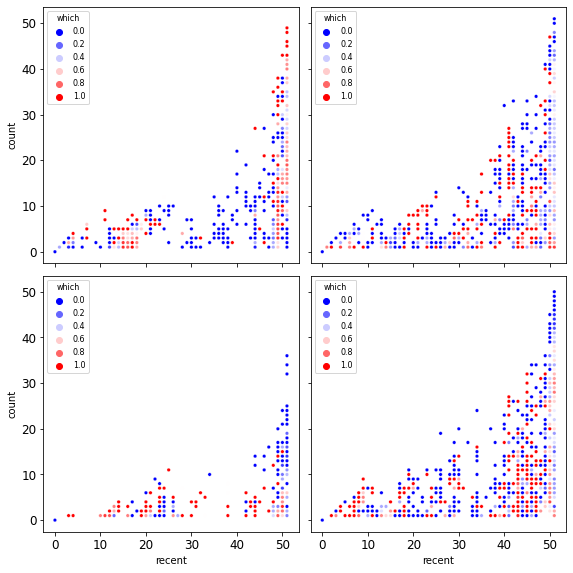

In [18]:
scatplt.plot()

In [66]:
# add state names
state_names = pd.read_csv("../data/state_names.csv")
print(state_names)
print(len(state_names))

state_names.num_code = state_names.num_code.apply(lambda x: '0' + str(x) if len(str(x))==1 else str(x))

state_names.head()

state_names.loc[state_names.num_code=='25']

              name letter_abbr  num_code
0          Alabama          AL         1
1           Alaska          AK         2
2          Arizona          AZ         4
3         Arkansas          AR         5
4       California          CA         6
5         Colorado          CO         8
6      Connecticut          CT         9
7         Delaware          DE        10
8          Florida          FL        11
9          Georgia          GA        12
10          Hawaii          HI        13
11           Idaho          ID        15
12        Illinois          IL        16
13         Indiana          IN        17
14            Iowa          IA        18
15          Kansas          KS        20
16        Kentucky          KY        21
17       Louisiana          LA        22
18           Maine          ME        23
19        Maryland          MD        24
20   Massachusetts          MA        25
21        Michigan          MI        26
22       Minnesota          MN        27
23     Mississip

,name,letter_abbr,num_code
20,Massachusetts,MA,25


In [7]:
# # add state names
# state_names = pd.read_html('https://en.wikipedia.org/wiki/Federal_Information_Processing_Standard_state_code')
# print(len(state_names))

# state_names = state_names[0]

# state_names.columns = ['name', 'letter_abbr', 'num_code', 'stat']

# state_names.drop('stat', axis=1, inplace=True)

# state_names.num_code = state_names.num_code.apply(lambda x: '0' + str(x) if len(str(x))==1 else str(x))

# state_names.head()

# state_names.loc[state_names.num_code=='25']

import matplotlib.pyplot as plt

from VASA.vasa import VASA
from VASA.BasePlot import BasePlot


class Strip(BasePlot):

    def __init__(self, v: VASA, cols=None):
        # fig, axes = plt.subplots(
        #     1,
        #     1,
        #     figsize=(8, 8)
        # )
        super().__init__("scatter", "striptest")

        #self.fig = fig
        #self.axes = [axes]
        self.v: VASA = v

    def plot(self):
        ndf = self.v.reduce("mode")
        ndf['state_num'] = [
            str(f // 1000) for f in ndf.fips
        ]  # .str.slice(start=0, stop=2)
        ndf['state_num'] = [
            ("0" + str(f//1000) if f//1000 < 10 else str(f//1000))
            for f in ndf.fips
        ]
        ndf = pd.merge(
            ndf,
            state_names,
            how='left',
            left_on='state_num',
            right_on='num_code'
        )

        counties_per_state = ndf.groupby(['fips','letter_abbr']) \
            .size() \
            .reset_index() \
            .rename(columns={0:'count'}) \
            .groupby('letter_abbr')['fips'] \
            .size() \
            .reset_index()

        check1 = usa_map \
            .groupby('STATEFP') \
            .size() \
            .reset_index() \
            .set_index("STATEFP") \
            .sort_index()

        check2 = ndf.groupby(['fips','num_code']) \
            .size() \
            .reset_index() \
            .rename(columns={0:'count'}) \
            .groupby('num_code')['fips'] \
            .size() \
            .reset_index() \
            .set_index('num_code') \
            .sort_index()

        #gdf.head()

        check1.columns = ['cnt']

        # print(counties_per_state)

        moder = ndf.loc[ndf[v.cols].sum(axis=1)>0,]
        lst_row = []

        for i in self.v.cols:
            g = moder[['letter_abbr', i]].groupby(['letter_abbr', i]).size().reset_index()
            g['source'] = i
            g.columns = ['letter_abbr', 'val', 'count', 'source']
            lst_row.append(g)

        cc = pd.concat(lst_row) 
        cc = cc.loc[cc.val!=0,]

        print("---- CC.head() ----")
        print(cc.groupby(["source", "val"]).size())

        print(cc.head())
        print(cc.shape)

        ppiv = cc.pivot(index=['letter_abbr', 'val'], columns='source', values='count')
        ppiv = ppiv.reset_index()

        print("--- ppiv.head() ---")
        print(ppiv.head())

        ppiv = ppiv[['letter_abbr', 'val', *self.v.cols]]


        msc = pd.merge(check1, state_names, left_on='STATEFP', right_on='num_code')
        ppiv = pd.merge(ppiv, msc, how='left', on='letter_abbr')

        last_idx = 2 + len(self.v.cols)

        ppiv.iloc[:, 2:last_idx] = ppiv.iloc[:, 2:last_idx].div(
            ppiv.cnt, axis=0
        ) * 100

        ppiv.iloc[:, 2:last_idx] = ppiv.iloc[:, 2:last_idx].apply(
            lambda x: round(x, 1)
        )

        #
        #
        #   PLOT
        #
        #

        sns.set_theme(style="whitegrid")
        #open_circle = mpl.path.Path(vert)

        text_style = dict(
            horizontalalignment='right',
            verticalalignment='center',
            fontsize=12,
            fontfamily='monospace'
        )

        print("--ppiv 2222222222 ---")
        print(ppiv.head())

        # Make the PairGrid
        g = sns.PairGrid(
            ppiv,
            x_vars=ppiv.columns[2:last_idx],
            y_vars=["letter_abbr"],
            hue='val',
            height=10,
            aspect=.25,
            palette=['red', 'blue']
        )

        print("HERE")

        # Draw a dot plot using the stripplot function
        g.map(
            sns.stripplot,
            size=10,
            orient="h",
            jitter=False,
            alpha=.65,
            linewidth=1
        )  # marker=r"$\circ$")#, alpha=0.5)

        print("DONE MAPPING")

        # Use the same x axis limits on all columns and add better labels
        g.set(xlim=(-5, 105), xlabel="", ylabel="")

        # Use semantically meaningful titles for the columns
        titles = ['SafeGraph \nmedian distance traveled', "2", "3", "4"]

        for ax, title in zip(g.axes.flat, titles):

            # Set a different title for each axes
            ax.set(title=title)

            # Make the grid horizontal instead of vertical
            ax.xaxis.grid(False)
            ax.yaxis.grid(True)

        sns.despine(left=True, bottom=True)

        fig = plt.gcf()
        self.fig = fig

        fig.text(
            0.5,
            0.02,
            '% of counties classified as hotspot / coldspot',
            ha='center'
        )

        # fig.savefig('/strip_plot_v2.jpeg', dpi=150, bbox_inches='tight')

    def save_plot(self, *args, **kwargs):
        #if not self.plotted:
        #    return

        super().save_plot(*args, **kwargs)


In [68]:
strp = Strip(v)

---- CC.head() ----
source                                val
cmi_7days_rolling_avg                 1      15
                                      2      20
                                      3       4
                                      4       2
sg_avg_dist2                          1       2
                                      2       6
                                      3       2
sg_sheltered                          1      22
                                      2      15
                                      3       1
                                      4       4
sheltered_in_place_7days_rolling_avg  1      23
                                      2      17
                                      4       3
dtype: int64
  letter_abbr  val  count        source
1          AL    2     50  sg_sheltered
3          AR    2     39  sg_sheltered
4          AR    4      1  sg_sheltered
6          AZ    1      6  sg_sheltered
8          CA    1     39  sg_sheltered
(136, 4)
--- 

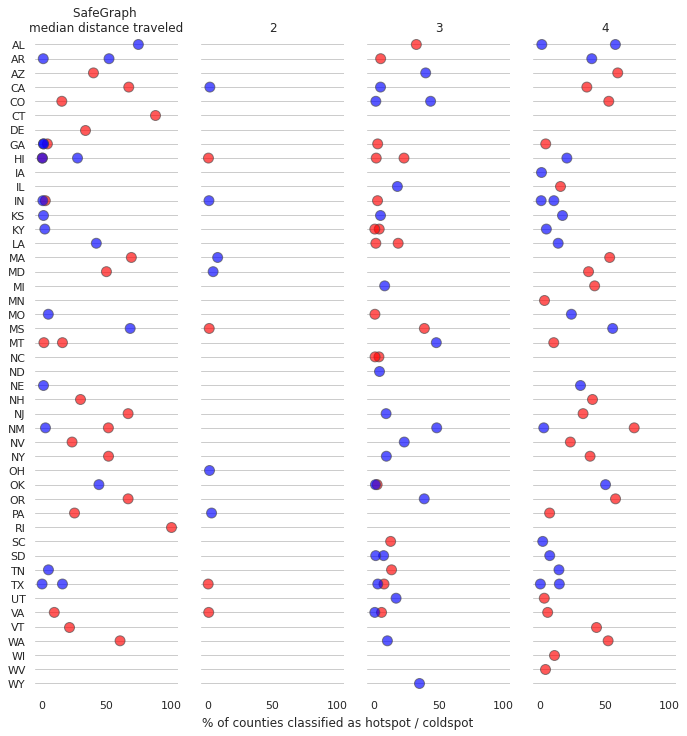

In [69]:
strp.plot()

In [28]:
strp.save_plot("strpplot_test")

<Figure size 432x288 with 0 Axes>

In [186]:

def summary(v):
    df = v.reduce("mode")

    print(df)

In [72]:
summary(v)

NameError: name 'summary' is not defined

In [8]:
import matplotlib.pyplot as plt

from VASA.vasa import VASA
from VASA.BasePlot import BasePlot


class Summary(BasePlot):

    def __init__(self, v: VASA, cols=None):
        fig, axes = plt.subplots(
            1,
            1,
            figsize=(8, 8)
        )
        super().__init__("scatter_test", "summary")

        self.fig = fig
        self.axes = [axes]
        self.v: VASA = v

    def plot(self):
        ndf = self.v.reduce("mode")
        ndf['state_num'] = [
            str(f // 1000) for f in ndf.fips
        ]  # .str.slice(start=0, stop=2)
        ndf['state_num'] = [
            ("0" + str(f//1000) if f//1000 < 10 else str(f//1000))
            for f in ndf.fips
        ]
        ndf = pd.merge(
            ndf,
            state_names,
            how='left',
            left_on='state_num',
            right_on='num_code'
        )

        ndf = ndf[ndf["state_num"] == "06"]["sg_sheltered"]

        dat = pd.concat(
            [self.v.df["date"].reset_index(drop=True), ndf.reset_index(drop=True)],
            axis=1
        ).dropna()
        print(dat)

          date  sg_sheltered
0   2020-01-01             1
1   2020-01-06             1
2   2020-01-13             1
3   2020-01-20             1
4   2020-01-27             0
5   2020-02-03             0
6   2020-02-10             1
7   2020-02-17             1
8   2020-02-24             1
9   2020-03-02             0
10  2020-03-09             1
11  2020-03-16             1
12  2020-03-23             0
13  2020-03-30             1
14  2020-04-06             1
15  2020-04-13             0
16  2020-04-20             0
17  2020-04-27             1
18  2020-05-04             1
19  2020-05-11             1
20  2020-05-18             0
21  2020-05-25             0
22  2020-06-01             1
23  2020-06-08             1
24  2020-06-15             1
25  2020-06-22             0
26  2020-06-29             1
27  2020-07-06             1
28  2020-07-13             1
29  2020-07-20             1
30  2020-07-27             0
31  2020-08-03             0
32  2020-08-10             0
33  2020-08-17

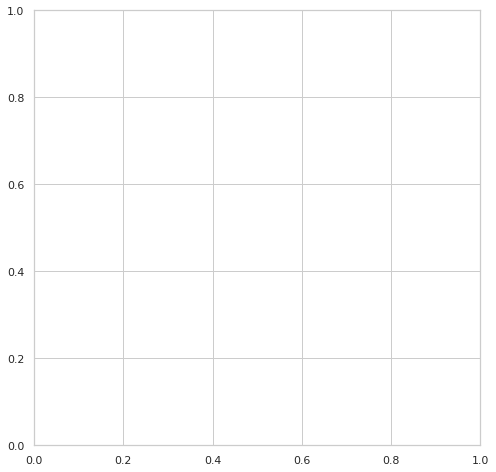

In [73]:
s = Summary(v)
s.plot()

In [9]:
#
#
#   Don't look through this, We're going to be changing the input to functions and
#   I've seen better ways to do some of the things here.
#
#

#
#
#
#
#

import os
import matplotlib.pyplot as plt
import numpy as np

def set_fig(f):
    def func(self, *args, **kwargs):
        plt.figure(self._fig.number)
        return f(self, *args, **kwargs)
    return func
    
class PlotUtility:
    
    def __init__(self, fig, output_folder):
        self._plot_font_size=12
        self._fig = fig
        self._output_folder = f"{output_folder}/"

        if not os.path.exists(output_folder):
            os.makedirs(output_folder)

    def hide_axis(self, ax):
        ax.set_xticks([])
        ax.set_yticks([])
        ax.spines["top"].set_visible(False)
        ax.spines["right"].set_visible(False)
        ax.spines["left"].set_visible(False)
        ax.spines["bottom"].set_visible(False)
    
    @set_fig
    def save_plot(self, title):
        self._fig.set_facecolor("w")
        plt.savefig(
            self._output_folder + title + ".png", 
            bbox_inches='tight', 
            dpi=150
        )

    @set_fig
    def reduce_padding(self):
        plt.subplots_adjust(hspace=0)

    # allows indexing of all dimensions
    def get_axis(self, axes, row, col):
        try:
            return axes[row, col] # dimension is some (n, m); n,m > 1
        except:
            try:
                return axes[col] if row == 1 else axes[row] # dimension is (1, n); n > 1
            except:
                return axes # dimension is (1, 1)

import matplotlib.pyplot as plt
from matplotlib import colors
import numpy as np
import pandas as pd
import geopandas as gpd
import math

class StackedChoropleth:
    
    def __init__(self, gpd_maps, export, cols, main_folder, desc="", titles='', plot_dim=None, fips_order=None):

        if not isinstance(gpd_maps, list):
            gpd_maps = [gpd_maps]

        if not isinstance(cols, list):
            cols = [cols]

        if not isinstance(titles, list):
            titles = [titles]

        if len(gpd_maps) > 1 and len(cols) > 1:
            raise "Can only specify multiple maps OR columns."

        if not plot_dim:
            tot = len(gpd_maps) * len(cols) 
            if tot > 1:
                plot_dim = (2, math.ceil(tot / 2))
            if tot == 1:
                plot_dim = (1, 1)    

        if plot_dim[0] * plot_dim[1] != len(cols) * len(gpd_maps) and plot_dim[0] * plot_dim[1] != len(cols) * len(gpd_maps) + 1:
            raise "Dimension does not match specified colums."

        self._gpd_maps = gpd_maps
        self._cols = cols
        self._export = export
        self._plot_dim = plot_dim
        self._desc = desc if desc else "-".join(cols)
        self._titles = titles if titles else cols

        self._fips_order = fips_order
        self._state_col = "STATEFP"

        self.count_subfolder = f'{main_folder}/count/'
        self.recent_subfolder = f'{main_folder}/recent/'
        self.both_subfolder = f'{main_folder}/combined/'
        self.scatter_subfolder = f'{main_folder}/scatter/'

        self._count_labels = ["Low Count", "High Count"]
        self._recent_labels = ["1/1/2020", "12/31/2020"]
        self._count_title = "Number of Weeks"
        self._recent_title = "Recency"

        self._plot_title_size = 14
        self._font_size = 12

        self._figsize = (10, 8)

    #
    #   MAPPING OPTIONS
    #

    def plot_count(self):
        if '_collapse_count_hot' not in locals():
            self.__collapse_count()

        self.__create_choropleth(
            self._collapse_count_hot, 
            self._collapse_count_cold, 
            typ=self._count_title, 
            labels=self._count_labels, # Start date to End Date
            figsize=self._figsize,
            output_folder=self.count_subfolder
        )

    def plot_recent(self):
        if '_collapse_recent_hot' not in locals():
            self.__collapse_recent()
        
        self.__create_choropleth(
            self._collapse_recent_hot, 
            self._collapse_recent_cold, 
            typ=self._recent_title, 
            labels=self._recent_labels, # maybe actual values?
            figsize=self._figsize,
            output_folder=self.recent_subfolder
        )

    def plot_both(self):
        if '_collapse_count_combined' not in locals():
            self.__collapse_count_combined()

        if '_collapse_recent_hot' not in locals():
            self.__collapse_recent()
        
        hots = self._collapse_recent_hot
        colds = self._collapse_recent_cold

        fig, axes = plt.subplots(
            self._plot_dim[0], 
            self._plot_dim[1], 
            figsize=self._figsize,
        )
        fig.tight_layout()
        #plt.subplots_adjust(hspace=0.1)

        utility = PlotUtility(fig, self.both_subfolder)
        utility.reduce_padding()

        # Since I'm restricting maps OR col to be a single item this is really a single loop:
        for map_idx, gpd_map in enumerate(self._gpd_maps):

            for j, col in enumerate(self._cols):

                map_copy = gpd_map.copy()

                map_copy["geometry"] = [
                    col.centroid.buffer(10000 + 11000/40 * count)
                    for col, count in zip(map_copy['geometry'], self._collapse_count_combined[map_idx + j])
                ]
                # Row wise:
                ax = utility.get_axis(axes, (map_idx + j) // self._plot_dim[0], (map_idx + j) % self._plot_dim[1])

                if True: #self._region and self._region[map_idx] == "usa":
                    ax.set_xlim([-0.235e7, 0.22e7])
                    ax.set_ylim([-1.75e6, 1.45e6])
                elif self._region[map_idx] == "ca":
                    ax.set_xlim([-2.60e6, -1.563e6])
                    ax.set_ylim([-1e6, 0.65e6])
                elif self._region[map_idx] == "fl":
                    ax.set_xlim([0.730e6, 1.570e6])
                    ax.set_ylim([-1.700e6, -0.950e6])
                elif self._region[map_idx] == "ny":
                    ax.set_xlim([1.1e6, 2.0e6])
                    ax.set_ylim([.03e6, 0.9e6])
                elif self._region[map_idx] == "tx":
                    ax.set_xlim([-0.990e6, 0.24e6])
                    ax.set_ylim([-1.75e6, -0.380e6])

                # if adding new state start with looking at state bounds:
                # print(gpd_map.total_bounds)

                norm = colors.Normalize(vmin=1, vmax=max([*hots[map_idx + j], *colds[map_idx + j]]))

                if len(self._titles) > 1:
                    ax.set_title(self._titles[map_idx + j], fontsize=self._plot_title_size)
                utility.hide_axis(ax)

                #self.__show_country_outline(ax, gpd_map)
                self.__show_state_outline(ax, gpd_map)
                self.__create_choropleth_map(hots[map_idx + j], ax, map_copy, self.__get_pallete("Reds"), norm)
                self.__create_choropleth_map(colds[map_idx + j], ax, map_copy, self.__get_pallete("Blues"), norm)
                
        if len(self._titles) == 1:
            fig.suptitle(self._titles[0], fontsize=self._plot_title_size)

        self.__create_choropleth_legend_horiz(fig, self._recent_title, self._recent_labels)
        self.__create_choropleth_legend_circles(fig, self._count_labels)
        utility.save_plot(self._desc)

    #
    #   MAP FEATURES
    #

    def __create_choropleth(self, hots, colds, typ, labels, figsize, output_folder):
        fig, axes = plt.subplots(
            self._plot_dim[0], 
            self._plot_dim[1], 
            figsize=figsize
        )
        fig.tight_layout()
        utility = PlotUtility(fig, output_folder)
        utility.reduce_padding()

        # Since I'm restricting maps OR col to be a single item this is really a single loop:
        for map_idx, gpd_map in enumerate(self._gpd_maps):

            for j, col in enumerate(self._cols):
                # Row wise:
                ax = utility.get_axis(axes, (map_idx + j) // self._plot_dim[0], (map_idx + j) % self._plot_dim[1])

                norm = colors.Normalize(vmin=0.5, vmax=max([*hots[map_idx + j], *colds[map_idx + j]]))
                ax.set_title(self._titles[map_idx + j], fontsize=self._plot_title_size)
                ax.set_axis_off()

                #self.__show_country_outline(ax, gpd_map)
                self.__show_state_outline(ax, gpd_map)
                self.__create_choropleth_map(hots[map_idx + j], ax, gpd_map, self.__get_pallete("Reds"), norm)
                self.__create_choropleth_map(colds[map_idx + j], ax, gpd_map, self.__get_pallete("Blues"), norm)
        
        self.__create_choropleth_legend_horiz(fig, typ, labels)

        utility.save_plot(self._desc)

    def __create_choropleth_map(self, data, ax, gpd_map, palette, norm, **kwargs):
        gpd_map \
            .assign(cl = data) \
            .plot(column='cl', k=2, cmap=palette, edgecolor='black', ax=ax, linewidth=0, norm=norm, **kwargs)

    def __create_choropleth_legend_horiz(self, fig, typ, labels):
        #
        #   THIS NEEDS TO BE LOOKED INTO
        #
        start_x = 0.12 
        start_y = -0.07 # 0 for non tight
        
        newa = fig.add_axes([start_x, start_y + 0.04, 0.3, 0.03])
        sm = plt.cm.ScalarMappable(cmap="Reds")
        cb = plt.colorbar(sm, cax=newa, ticks=[], orientation="horizontal")
        cb.ax.tick_params(size=0)
        cb.ax.set_xlabel(typ, fontsize=self._font_size)
        cb.ax.xaxis.set_label_position("top")
        cb.ax.set_ylabel("Hot Spots", rotation=0, labelpad=35, y=0.125, fontsize=self._font_size)

        newa = fig.add_axes([start_x, start_y + 0, 0.3, 0.03])
        sm = plt.cm.ScalarMappable(cmap="Blues")
        cb = plt.colorbar(sm, cax=newa, ticks=[0.1, 0.875], orientation="horizontal")
        cb.ax.set_xticklabels(labels, fontsize=self._font_size)
        cb.ax.tick_params(size=0)
        cb.ax.set_ylabel("Cold Spots", rotation=0, labelpad=35, y=0.125, fontsize=self._font_size)

    def __create_choropleth_legend_vert(self, fig, typ, labels):
        #
        #   THIS NEEDS TO BE ADDED
        #
        return 1

    def __create_choropleth_legend_circles(self, fig, labels):
        start_y = -0.06 # 0 for non tight
        start_x = .58 # 0.5 for non tight
        
        if self._plot_dim[0] == 1 and self._plot_dim[1] == 1:
            point_scale = lambda i: (15000 + 55000/40 * i) / 2500
        else:
            point_scale = lambda i: (10000 + 11000/40 * i) / 2500

        newa = fig.add_axes([start_x, start_y + 0.07, 0.3, 0.03])
        points = [1, 5, 10, 20, 52]
        point_lgd = [plt.scatter([],[], s=point_scale(i), marker='o', color='k') for i in points]
        newa.legend(point_lgd, points, frameon=False, title=self._count_title, ncol=5, handlelength=0.1)
        newa.set_axis_off()


    #
    #   UTILITY MAPPING FUNCTIONS
    #

    def __show_country_outline(self, ax, gpd_map):
        gpd_map \
            .assign(dissolve = 0) \
            .dissolve(by="dissolve") \
            .plot(color="#FFFFFF00", ax=ax, edgecolor='black', linewidth=3)
        
    def __show_state_outline(self, ax, gpd_map):
        gpd_map \
            .dissolve(by=self._state_col) \
            .plot(color="#FFFFFF00", ax=ax, edgecolor='black', linewidth=1)

    def __get_pallete(self, which):
        import copy

        palette = copy.copy(plt.get_cmap(which))
        palette.set_under("#FFFFFF00", 0)
        return palette

    #
    #   CALCULATIONS:
    #
    def __collapse_count_combined(self):
        collapsed = {}

        for map_idx, gpd_map in enumerate(self._gpd_maps):
            for i, col in enumerate(self._cols):
                stacked = np.array([0] * gpd_map.shape[0])

                for week_arr in self._export[col]:
                    arr = [(a != 0) for a in self.__filter_state(gpd_map, week_arr)]
                    stacked = stacked + arr

                collapsed[map_idx + i] = stacked

        # set second title label to max number ??

        self._collapse_count_combined = collapsed

    def __collapse_count(self):
        collapsed_hot = {}
        collapsed_cold = {}

        for map_idx, gpd_map in enumerate(self._gpd_maps):
            for i, col in enumerate(self._cols):

                length = gpd_map.shape[0]

                stacked_hot = np.array([0] * length)
                stacked_cold = np.array([0] * length)

                for week_arr in self._export[col]:
                    arr_hot, arr_cold = list(zip(*[(a % 2 == 1, a != 0 and a % 2 == 0) for a in self.__filter_state(gpd_map, week_arr)]))
                    stacked_hot = stacked_hot + arr_hot
                    stacked_cold = stacked_cold + arr_cold

                collapsed_hot[map_idx + i] = stacked_hot
                collapsed_cold[map_idx + i] = stacked_cold

        # set second title label to max number ??

        self._collapse_count_hot = collapsed_hot
        self._collapse_count_cold = collapsed_cold
        
    def __collapse_recent(self):
        collapsed_hot = {}
        collapsed_cold = {}


        for map_idx, gpd_map in enumerate(self._gpd_maps):
            for i, col in enumerate(self._cols):

                length = gpd_map.shape[0]

                stacked_hot = [0] * length
                stacked_cold = [0] * length

                for week_num, week_arr in enumerate(self._export[col]):
                    arr_hot, arr_cold = list(zip(*[
                        ((week_num + 1) * (a % 2 == 1), (week_num + 1) * (a % 2 == 0 and a != 0)) 
                        for a in self.__filter_state(gpd_map, week_arr)
                    ]))
                    stacked_hot = [max(arr_hot[i], stacked_hot[i]) for i in range(length)]
                    stacked_cold = [max(arr_cold[i], stacked_cold[i]) for i in range(length)]

                # If hot and cold, pick most recent value ---- should be by cound I thinkk ahh
                for j, (h, c) in enumerate(zip(stacked_hot, stacked_cold)):
                    if h > 0 and c > 0:
                        if h > 0:
                            stacked_cold[j] = 0
                        else:
                            stacked_hot[j] = 0

                collapsed_hot[map_idx + i] = stacked_hot
                collapsed_cold[map_idx + i] = stacked_cold

        self._collapse_recent_hot = collapsed_hot
        self._collapse_recent_cold = collapsed_cold

    def __filter_state(self, map_data, arr):
    
        if self._fips_order is None:
            return arr
        
        data = pd.DataFrame()
        data["fips"] = self._fips_order
        data["val"] = arr

        return map_data.merge(data, how="left", on="fips")["val"]

    #
    #
    #   ALTERNATIVE MAPS
    #   
    #

    def __create_scatter(self, ax, xs, ys):
        ax.scatter(xs, ys, c="blue", alpha=0.3)
        ax.plot(range(0, max(xs) + 1), range(0, max(xs) + 1))

    def scatter(self):
        if '_collapse_count_combined' not in locals():
            self.__collapse_count_combined()

        if '_collapse_recent_hot' not in locals():
            self.__collapse_recent()
        
        fig, axes = plt.subplots(
            self._plot_dim[0], 
            self._plot_dim[1], 
            figsize=self._figsize
        )
        fig.tight_layout()
        utility = PlotUtility(fig, self.scatter_subfolder)
        utility.reduce_padding()

        # Since I'm restricting maps OR col to be a single item this is really a single loop:
        for map_idx, gpd_map in enumerate(self._gpd_maps):

            for j, col in enumerate(self._cols):
                # Row wise:
                ax = utility.get_axis(axes, (map_idx + j) // self._plot_dim[0], (map_idx + j) % self._plot_dim[1])

                ys = self._collapse_count_combined[map_idx + j]
                xs = [(a if a > b else b) for a, b in zip(self._collapse_recent_hot[map_idx + j], self._collapse_recent_cold[map_idx + j])]

                ax.set_title(self._titles[map_idx + j], fontsize=self._plot_title_size)
                self.__create_scatter(ax, xs, ys)    

        utility.save_plot(self._desc)

    def separate_hot_cold(self):
        if '_collapse_count_hot' not in locals():
            self.__collapse_count()

        if '_collapse_recent_hot' not in locals():
            self.__collapse_recent()
        
        fig, axes = plt.subplots(
            self._plot_dim[0] * self._plot_dim[1], 
            2, 
            figsize=self._figsize
        )
        fig.tight_layout()
        utility = PlotUtility(fig, self.scatter_subfolder)
        utility.reduce_padding()

        hots = self._collapse_count_hot
        colds = self._collapse_count_cold

        # Since I'm restricting maps OR col to be a single item this is really a single loop:
        for map_idx, gpd_map in enumerate(self._gpd_maps):

            for j, col in enumerate(self._cols):
                # Row wise:
                ax_hot = utility.get_axis(axes, map_idx + j, 0)
                ax_cold = utility.get_axis(axes, map_idx + j, 1)

                norm = colors.Normalize(vmin=0.5, vmax=max([*hots[map_idx + j], *colds[map_idx + j]]))
                ax_hot.set_title(self._titles[map_idx + j], fontsize=self._plot_title_size)
                ax_cold.set_title(self._titles[map_idx + j], fontsize=self._plot_title_size)
                ax_hot.set_axis_off()
                ax_cold.set_axis_off()

                #self.__show_country_outline(ax, gpd_map)
                self.__show_state_outline(ax_hot, gpd_map)
                self.__show_state_outline(ax_cold, gpd_map)
                self.__create_choropleth_map(hots[map_idx + j], ax_hot, gpd_map, self.__get_pallete("Reds"), norm)
                self.__create_choropleth_map(colds[map_idx + j], ax_cold, gpd_map, self.__get_pallete("Blues"), norm)
        

        utility.save_plot(self._desc)

    def hot_cold(self):
        if '_collapse_count_hot' not in locals():
            self.__collapse_count()

        if '_collapse_recent_hot' not in locals():
            self.__collapse_recent()
        
        fig, axes = plt.subplots(
            self._plot_dim[0], 
            self._plot_dim[1], 
            figsize=self._figsize
        )
        fig.tight_layout()
        utility = PlotUtility(fig, self.scatter_subfolder)
        utility.reduce_padding()

        hots = self._collapse_count_hot
        colds = self._collapse_count_cold

        # Since I'm restricting maps OR col to be a single item this is really a single loop:
        for map_idx, gpd_map in enumerate(self._gpd_maps):

            for j, col in enumerate(self._cols):
                # Row wise:
                ax = utility.get_axis(axes, (map_idx + j) // self._plot_dim[0], (map_idx + j) % self._plot_dim[1])

                norm = colors.Normalize(vmin=0.5, vmax=max([*hots[map_idx + j], *colds[map_idx + j]]))
                ax.set_title(self._titles[map_idx + j], fontsize=self._plot_title_size)
                ax.set_axis_off()

                #self.__show_country_outline(ax, gpd_map)
                self.__show_state_outline(ax, gpd_map)
                self.__create_choropleth_map(hots[map_idx + j], ax, gpd_map, self.__get_pallete("Reds"), norm)
                self.__create_choropleth_map(colds[map_idx + j], ax, gpd_map, self.__get_pallete("Blues"), norm)
        

        utility.save_plot(self._desc)

In [75]:
mob_data = pd.read_csv("../data/all_minor_sources.csv")

# THIS CELL MAY NEED TO BE CHANGED

# Make sure this string matches the column name for the mobility values
# If you have multiple measures in your dataset, it's easiest if you just pick one
columns = [
    'sg_sheltered', "sg_avg_dist2"
]

# Make sure this string matches the column name you have for the dates
date_col = "ds_m4"

# Make sure this string matches the column name you have for the county fips
fips_col = "fips"



# This is just used to put text on the plot, it doesn't really make what it says...
titles = [
    '% sheltered (Safegraph)', "Avg Dist"
]

In [76]:
mob_data

,fips,ds_m4,all_day_bing_tiles_visited_relative_change,all_day_ratio_single_tile_users,dex,num_devices,dex_a,num_devices_a,state_m2,county_m2,...,cmi,userbase_share,cue_devices,sheltered_in_place_7days_rolling_avg,state_name,county_name,county_vmt,sg_sheltered,sg_avg_dist2,device_count
0,45035,2020-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3.575363,0.000667,40672.255666,0.282728,South Carolina,Dorchester,2440000.0,0.319371,11066.255084,11889.0
1,45035,2020-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3.989247,0.000677,41266.684594,0.279174,South Carolina,Dorchester,3400000.0,0.257536,13048.934918,11412.0
2,45035,2020-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,4.030501,0.000686,41851.595967,0.275851,South Carolina,Dorchester,3950000.0,0.246068,13383.727687,11444.0
3,45035,2020-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3.905002,0.000682,41587.471566,0.278619,South Carolina,Dorchester,3570000.0,0.281261,11845.334563,11548.0
4,45035,2020-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3.716130,0.000678,41352.963981,0.278791,South Carolina,Dorchester,2810000.0,0.312370,9796.491319,11512.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1212035,22069,2021-01-16,-0.11594,0.17967,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,Louisiana,Natchitoches,1170000.0,NaN,NaN,NaN
1212036,22069,2021-01-17,-0.15502,0.23221,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,Louisiana,Natchitoches,828000.0,NaN,NaN,NaN
1212037,22069,2021-01-18,-0.11548,0.18918,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,Louisiana,Natchitoches,1150000.0,NaN,NaN,NaN
1212038,22069,2021-01-19,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,Louisiana,Natchitoches,869000.0,NaN,NaN,NaN


In [ ]:
mob_data = mob_data[["ds_m4", "fips", *columns]]

# Read the map 
usa_map_data = pd.read_json("../data/counties.json")
usa_map = gpd.GeoDataFrame \
    .from_features(usa_map_data["features"]) \
    .set_crs(epsg=4326) \
    .to_crs("+proj=aea +lat_1=20 +lat_2=60 +lat_0=40 +lon_0=-96 +x_0=0 +y_0=0 +datum=NAD83 +units=m +no_defs")
usa_map = usa_map.assign(fips=[int(g) for g in usa_map["GEOID"]])
usa_map = filter_map(usa_map)

# Group the data into weeks
data = filter_data(mob_data, fips_col)
# grouped_usa = group_data(data, columns, date_col, fips_col, by="week")

In [58]:
all_counties = gpd.read_file("../data/ca_cbg")
#counties = all_counties[[c in ["037", "111", "029", "059"] for c in all_counties["COUNTYFP"]]]
counties = all_counties[[c in ["037"] for c in all_counties["COUNTYFP"]]] # just LA



In [59]:
counties

,STATEFP,COUNTYFP,TRACTCE,BLKGRPCE,GEOID,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
7,06,037,104404,1,060371044041,Block Group 1,G5030,S,274050,0,+34.2657170,-118.4262294,"POLYGON ((-118.43035 34.26535, -118.42871 34.2..."
8,06,037,104703,1,060371047031,Block Group 1,G5030,S,873636,0,+34.2554387,-118.3990855,"POLYGON ((-118.40413 34.25281, -118.40243 34.2..."
15,06,037,124903,2,060371249032,Block Group 2,G5030,S,136553,0,+34.1666107,-118.3984128,"POLYGON ((-118.40033 34.16670, -118.40033 34.1..."
17,06,037,104703,2,060371047032,Block Group 2,G5030,S,294603,0,+34.2545911,-118.4050450,"POLYGON ((-118.40909 34.25446, -118.40729 34.2..."
18,06,037,104704,1,060371047041,Block Group 1,G5030,S,681800,0,+34.2630211,-118.4068900,"POLYGON ((-118.41321 34.26232, -118.41320 34.2..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
23753,06,037,536102,2,060375361022,Block Group 2,G5030,S,2289684,273643,+33.9431242,-118.1690175,"POLYGON ((-118.17616 33.93164, -118.17611 33.9..."
23866,06,037,535902,3,060375359023,Block Group 3,G5030,S,241595,0,+33.9394426,-118.1965067,"POLYGON ((-118.19842 33.93645, -118.19831 33.9..."
23867,06,037,535902,4,060375359024,Block Group 4,G5030,S,335281,0,+33.9398239,-118.2002289,"POLYGON ((-118.20267 33.93749, -118.20261 33.9..."
23868,06,037,536000,1,060375360001,Block Group 1,G5030,S,938998,0,+33.9562929,-118.1915805,"POLYGON ((-118.19789 33.95376, -118.19778 33.9..."


In [60]:
counties_map = gpd.GeoDataFrame \
    .from_features(counties) \
    .set_crs(epsg=4326) \
    .to_crs("+proj=aea +lat_1=20 +lat_2=60 +lat_0=40 +lon_0=-96 +x_0=0 +y_0=0 +datum=NAD83 +units=m +no_defs")

<AxesSubplot:>

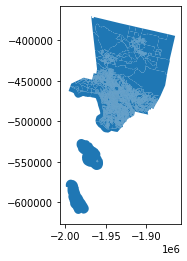

In [61]:
counties_map.plot(linewidth=0)

In [3]:
import pandas as pd

In [8]:
cbg_data = pd.read_csv("../data/sg_cbg.csv")

In [9]:
cbg_data.head()

,origin_census_block_group,date_range_start,device_count,distance_traveled_from_home,bucketed_distance_travelled,completely_home_device_count,median_percentage_time_home,mean_distance_traveled_from_home,county_fips,cbg_fips
0,60014075002,2019-12-21 08:00:00+00:00,71,1598.0,"{""16001-50000"":4,""0"":27,"">50000"":5,""2001-8000""...",28,95,22833.0,6001,60014075002
1,60190057022,2019-12-21 08:00:00+00:00,80,3227.0,"{""16001-50000"":5,""0"":26,"">50000"":1,""2001-8000""...",26,88,4215.0,6019,60190057022
2,60210101002,2019-12-21 08:00:00+00:00,101,2405.0,"{""16001-50000"":29,""0"":27,"">50000"":15,""2001-800...",30,88,19155.0,6021,60210101002
3,60290060071,2019-12-21 08:00:00+00:00,81,4593.0,"{""16001-50000"":3,""0"":23,"">50000"":22,""2001-8000...",21,81,21754.0,6029,60290060071
4,60310016011,2019-12-21 08:00:00+00:00,82,4056.0,"{""16001-50000"":17,""0"":23,"">50000"":14,""2001-800...",23,79,12784.0,6031,60310016011


In [10]:
selected_county_data = cbg_data[[c in [6037, 6111, 6029, 6059] for c in cbg_data["county_fips"]]][["distance_traveled_from_home", "cbg_fips", "date_range_start"]]

In [11]:
selected_county_data.to_csv("../data/select_counties.csv")

In [11]:
selected_county_data.head()

,distance_traveled_from_home,cbg_fips,date_range_start
3,4593.0,60290060071,2019-12-21 08:00:00+00:00
5,3445.0,60371012201,2019-12-21 08:00:00+00:00
6,2332.0,60371066452,2019-12-21 08:00:00+00:00
7,4929.0,60371210102,2019-12-21 08:00:00+00:00
8,3385.0,60371342012,2019-12-21 08:00:00+00:00


In [12]:
selected_county_data["fips"] = ["0" + str(f) for f in selected_county_data["cbg_fips"]]

<AxesSubplot:>

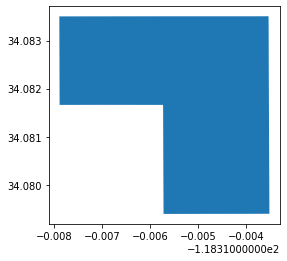

In [62]:
gpd.GeoDataFrame(counties.iloc[5330,]).T.plot()


In [14]:
counties = counties.reset_index().drop([5330])

In [71]:
to_remove = ["060375991001"]

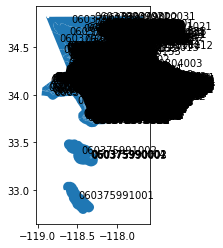

In [70]:
import matplotlib.pyplot as plt
counties.plot()
for idx, row in counties.iterrows():
    plt.annotate(text=row["GEOID"], xy=row["geometry"].centroid.coords[0])

In [73]:
selected_county_data = selected_county_data.drop("cbg_fips", axis=1)
selected_county_data = selected_county_data[[f not in to_remove for f in selected_county_data["fips"]]]

In [15]:
counties.head()

,index,STATEFP,COUNTYFP,TRACTCE,BLKGRPCE,GEOID,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,7,06,037,104404,1,060371044041,Block Group 1,G5030,S,274050,0,+34.2657170,-118.4262294,"POLYGON ((-118.43035 34.26535, -118.42871 34.2..."
1,8,06,037,104703,1,060371047031,Block Group 1,G5030,S,873636,0,+34.2554387,-118.3990855,"POLYGON ((-118.40413 34.25281, -118.40243 34.2..."
2,15,06,037,124903,2,060371249032,Block Group 2,G5030,S,136553,0,+34.1666107,-118.3984128,"POLYGON ((-118.40033 34.16670, -118.40033 34.1..."
3,17,06,037,104703,2,060371047032,Block Group 2,G5030,S,294603,0,+34.2545911,-118.4050450,"POLYGON ((-118.40909 34.25446, -118.40729 34.2..."
4,18,06,037,104704,1,060371047041,Block Group 1,G5030,S,681800,0,+34.2630211,-118.4068900,"POLYGON ((-118.41321 34.26232, -118.41320 34.2..."


In [51]:
v1 = VASA(selected_county_data, counties, gdf_group_col="GEOID", date_col="date_range_start", date_format="%Y-%m-%d %H:%M:%S%z")

In [52]:
v1.group()

In [44]:
selected_county_data.drop("cbg_fips", axis=1)

,distance_traveled_from_home,cbg_fips,date_range_start,fips
3,4593.0,60290060071,2019-12-21 08:00:00+00:00,060290060071
5,3445.0,60371012201,2019-12-21 08:00:00+00:00,060371012201
6,2332.0,60371066452,2019-12-21 08:00:00+00:00,060371066452
7,4929.0,60371210102,2019-12-21 08:00:00+00:00,060371210102
8,3385.0,60371342012,2019-12-21 08:00:00+00:00,060371342012
...,...,...,...,...
7294964,1822.0,60375736013,2020-11-11 08:00:00+00:00,060375736013
7294965,1393.0,60375740003,2020-11-11 08:00:00+00:00,060375740003
7294966,390.0,60376511022,2020-11-11 08:00:00+00:00,060376511022
7294971,1414.0,60590864061,2020-11-11 08:00:00+00:00,060590864061


In [53]:
v1.lisa()

/home/alex/Desktop/github/VASA/myenv/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)


In [57]:
v1.df

,date,distance_traveled_from_home
0,2019-12-21,"[0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, ..."
1,2019-12-23,"[0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, ..."
2,2019-12-30,"[0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, ..."
3,2020-01-06,"[0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, ..."
4,2020-01-13,"[0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, ..."
5,2020-01-20,"[0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, ..."
6,2020-01-27,"[0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, ..."
7,2020-02-03,"[0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, ..."
8,2020-02-10,"[0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, ..."
9,2020-02-17,"[0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, ..."
